In [1]:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'
#!pip install torch==1.10.2 torchvision==0.11.3 --extra-index-url https://download.pytorch.org/whl/cu113
#!pip install setuptools==59.5.0 --upgrade

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-hd5oj6i4
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-hd5oj6i4
  Resolved https://github.com/facebookresearch/detectron2.git to commit 830d7967966b92bb357c06c52edf0d39a3e2d89d
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 50 kB 8.7 MB/s eta 0:00:011
     |████████████████████████████████| 79 kB 29.4 MB/s eta 0:00:01
     |████████████████████████████████| 154 kB 54.5 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 56.2 MB/s eta 0:00:01
     |████████████████████████████████| 117 kB 52.6 MB/s eta 0:00:01
     |████████████████████████████████| 42 kB 27.3 MB/s eta 0:00:01
  Created wheel for detectron2: filename=detectron2-0.6-cp38-cp38-linux_x86

In [2]:
import json
import pathlib
from datasets import load_dataset
CLASS_NAME = "frog_stomach"
FROG_IMAGES = "./frog_photos"
FROG_DATASET = pathlib.Path("perara/pelophylax_lessonae")




# TODO data loader path
OUTPUT_DIR = pathlib.Path("pytorch_weights")
OUTPUT_DIR.mkdir(exist_ok=True)
FROG_PHOTOS = pathlib.Path("frog_photos")

VALIDATION_DATA_PATH = pathlib.Path(FROG_DATASET).joinpath("data/validation.json")
TRAINING_DATA_PATH = pathlib.Path(FROG_DATASET).joinpath("data/training.json")

In [3]:
"""train_data = load_dataset(
    str(FROG_DATASET),
    name="default",
    splits=["train", "validation"],
    image_dir=str(FROG_PHOTOS.absolute()),
    dataset_dir=str(FROG_DATASET.absolute())
)

print(train_data.cache_files)"""

'train_data = load_dataset(\n    str(FROG_DATASET),\n    name="default",\n    splits=["train", "validation"],\n    image_dir=str(FROG_PHOTOS.absolute()),\n    dataset_dir=str(FROG_DATASET.absolute())\n)\n\nprint(train_data.cache_files)'

In [3]:
%load_ext tensorboard
%tensorboard --logdir /home/per/Downloads/Auto-Annotate/frog_identity_recognition/pytorch_weights

In [4]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("frog_stomach_train", {}, str(TRAINING_DATA_PATH.absolute()), str(FROG_PHOTOS.absolute()))
register_coco_instances( "frog_stomach_val", {}, str(VALIDATION_DATA_PATH.absolute()), str(FROG_PHOTOS.absolute()))

ImportError: libGL.so.1: cannot open shared object file: No such file or directory

In [6]:
from detectron2.config import get_cfg
from detectron2 import model_zoo

"""
"""
def custom_config(num_classes):
    cfg = get_cfg()

    # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))


    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    cfg.MODEL.MASK_ON = True
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes
    cfg.MODEL.RESNETS.DEPTH = 34
    cfg.MODEL.RESNETS.RES2_OUT_CHANNELS = 64

    # Solver
    cfg.SOLVER.BASE_LR = 0.0002
    cfg.SOLVER.MAX_ITER = 70000
    cfg.SOLVER.STEPS = (20, 10000, 20000, 30000, 40000, 50000)
    cfg.SOLVER.gamma = 0.5
    cfg.SOLVER.IMS_PER_BATCH = 4
    cfg.SOLVER.CHECKPOINT_PERIOD = 5000


    # Test
    cfg.TEST.DETECTIONS_PER_IMAGE = 20
    #cfg.TEST.EVAL_PERIOD = 5

    # INPUT
    cfg.INPUT.MIN_SIZE_TRAIN = (800,)

    # DATASETS
    cfg.DATASETS.TEST = ('frog_stomach_val',)
    cfg.DATASETS.TRAIN = ('frog_stomach_train',)

    # DATASETS
    cfg.OUTPUT_DIR = str(OUTPUT_DIR.absolute())

    return cfg




In [9]:
from detectron2.engine import DefaultTrainer

cfg = custom_config(num_classes=1)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)



[10/03 15:15:41 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2):

In [10]:
trainer.train()

[10/03 15:15:43 d2.engine.train_loop]: Starting training from iteration 70000
[10/03 15:15:43 d2.engine.hooks]: Total training time: 0:00:00 (0:00:00 on hooks)
[10/03 15:15:46 d2.data.datasets.coco]: Loading /home/per/Downloads/Auto-Annotate/frog_identity_recognition/pelophylax_lessonae/data/validation.json takes 2.36 seconds.
[10/03 15:15:46 d2.data.datasets.coco]: Loaded 757 images in COCO format from /home/per/Downloads/Auto-Annotate/frog_identity_recognition/pelophylax_lessonae/data/validation.json
[10/03 15:15:46 d2.data.build]: Distribution of instances among all 1 categories:
|   category   | #instances   |
|:------------:|:-------------|
| frog_stomach | 757          |
|              |              |
[10/03 15:15:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/03 15:15:46 d2.data.common]: Serializing 757 elements to byte tensors and concatenating them all ..

In [40]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.engine import DefaultPredictor

cfg.MODEL.WEIGHTS = str(pathlib.Path(cfg.OUTPUT_DIR).joinpath("model_final.pth").absolute())

predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("frog_stomach_val", tasks=("bbox", "segm"), output_dir=str(OUTPUT_DIR.absolute()))
val_loader = build_detection_test_loader(cfg, "frog_stomach_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))



[10/03 15:39:33 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                    |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)       |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)       |
| backbone.bottom_up.res2.1.conv1.*               | backbone.bottom_up.res2.1.conv1.{norm.bias,norm.running_mean,norm

In [39]:
from detectron2.evaluation import RotatedCOCOEvaluator, LVISEvaluator, SemSegEvaluator

predictor = DefaultPredictor(cfg)
evaluator = SemSegEvaluator("frog_stomach_val", output_dir=str(OUTPUT_DIR.absolute()))
val_loader = build_detection_test_loader(cfg, "frog_stomach_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))



[10/03 15:38:52 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                    |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)       |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)       |
| backbone.bottom_up.res2.1.conv1.*               | backbone.bottom_up.res2.1.conv1.{norm.bias,norm.running_mean,norm

KeyError: 'sem_seg_file_name'

In [46]:
import json
validation_data = json.loads(VALIDATION_DATA_PATH.read_text())

print(len(json.loads(VALIDATION_DATA_PATH.read_text())["images"]))
print(len(json.loads(TRAINING_DATA_PATH.read_text())["images"]))


757
255


757


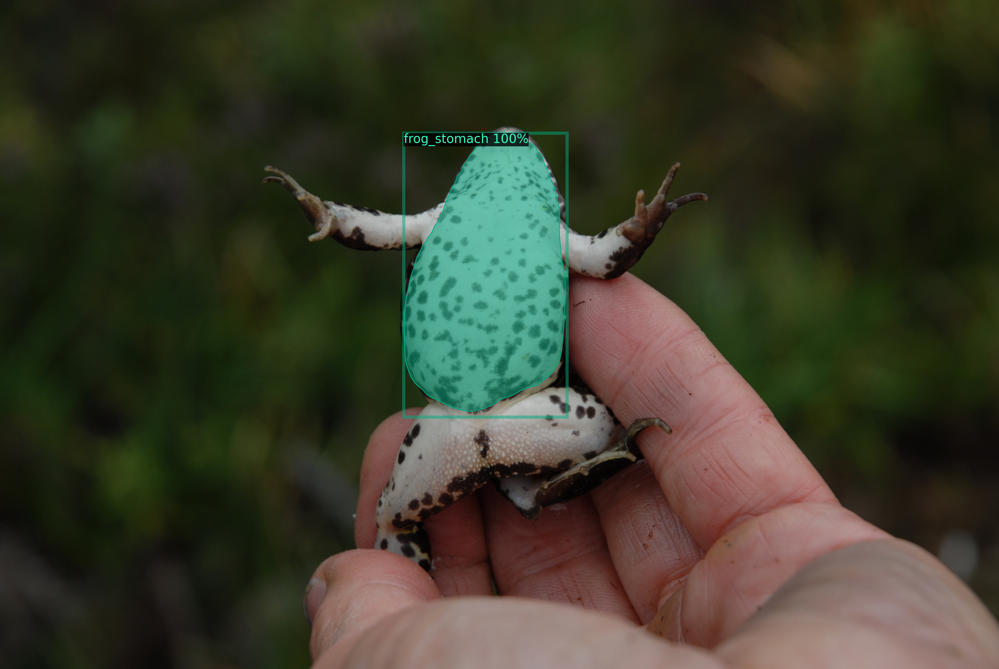

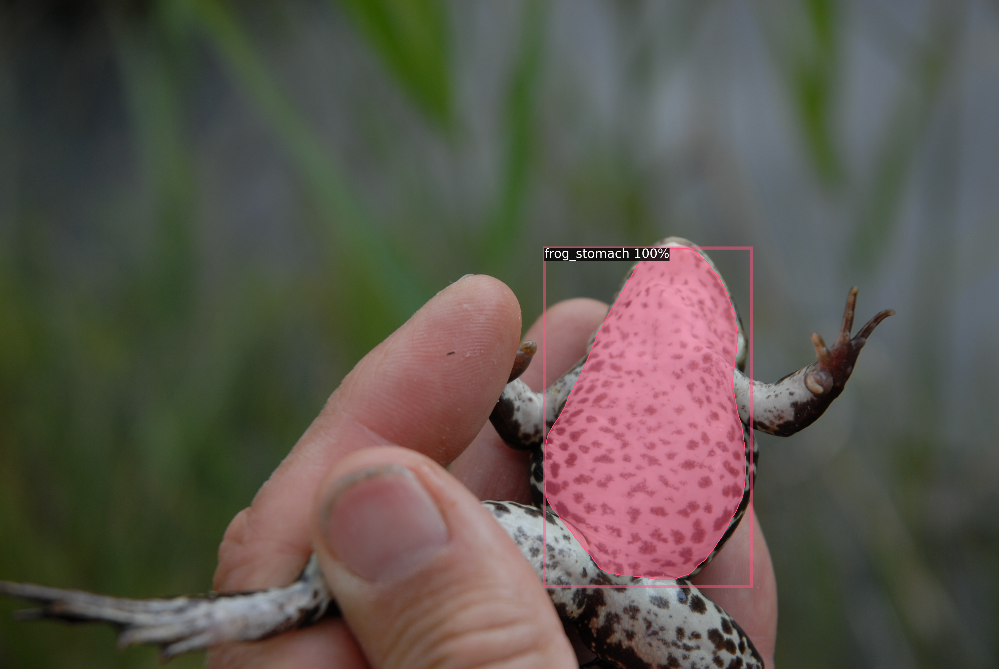

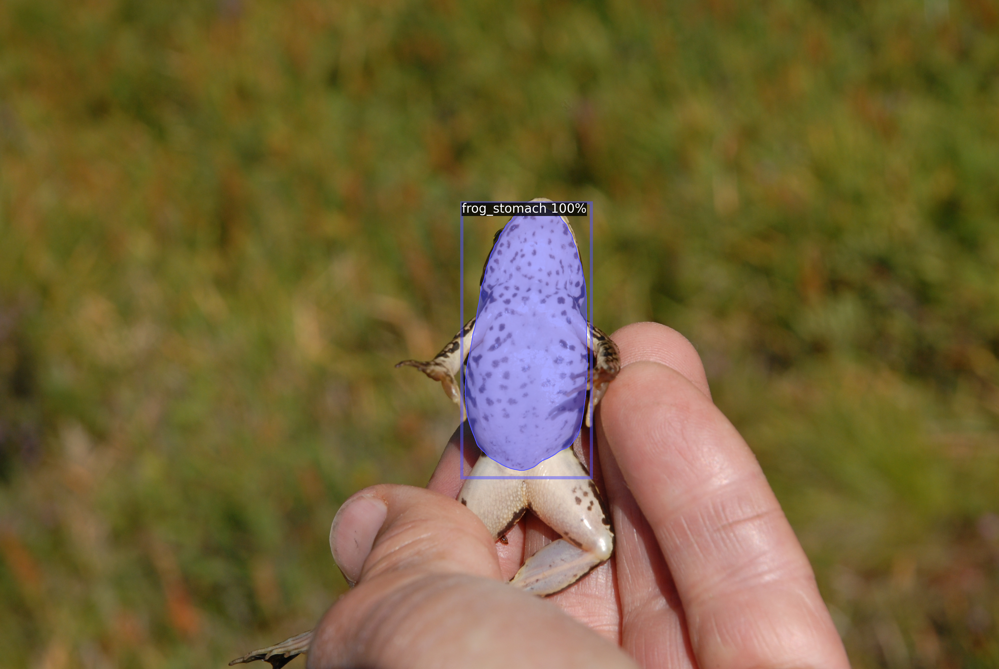

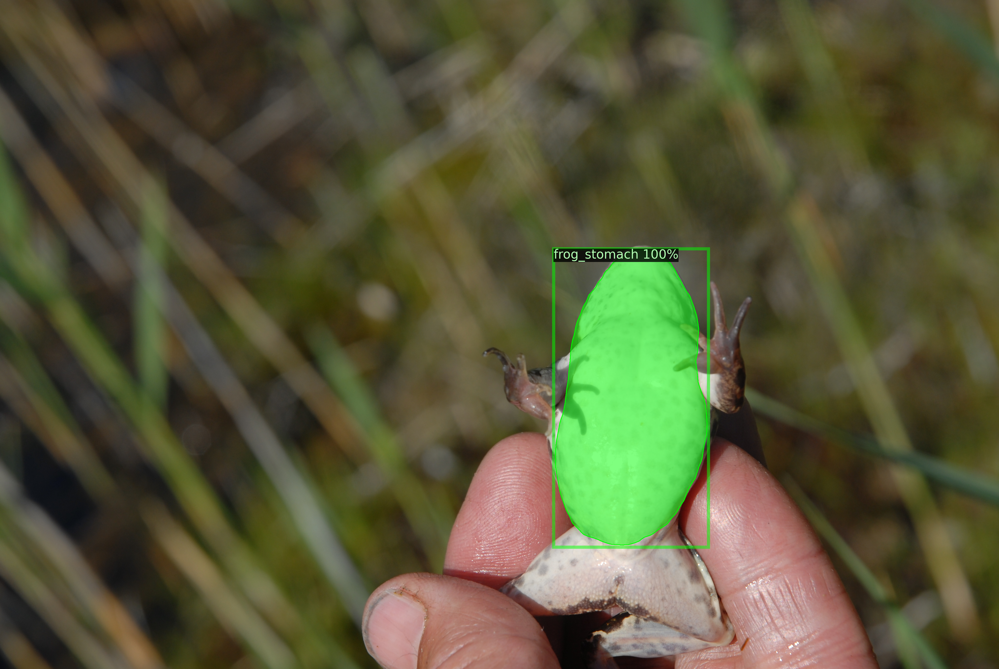

KeyboardInterrupt: 

In [49]:
from PIL import Image
from detectron2.structures import Instances
from detectron2.utils.visualizer import VisImage
import numpy as np
import cv2
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer
print(len(validation_data["images"]))
for item in validation_data["images"]:
    image_file = item["file_name"]


    img: np.ndarray = cv2.imread(str(FROG_PHOTOS.joinpath(image_file).absolute()))

    output: Instances = predictor(img)["instances"]
    v = Visualizer(img[:, :, ::-1],MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.0)
    result: VisImage = v.draw_instance_predictions(output.to("cpu"))
    result_image: np.ndarray = result.get_image()[:, :, ::-1]

    display(Image.fromarray(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB)).resize((300, 300)))

    #cv2.imwrite(out_file_name, result_image)